# Taller 1: Multi Armed Bandits (MAB)

Este *Notebook* contiene un simple ejemplo de como interactuar con los escenarios propuestos para realizar el **Taller 1: Multi Armed Bandits** del curso de *Reinforcement Learning* (IELE-4922) de la Universidad de los Andes. 

## BanditEnvs

### Importar clase

La clase se importa desde el archivo envs.pyc (adjunto a la guía de este taller). Para esto puede subir el archivo manualmente a su GoogleDrive o clonarlo desde el repositorio de github.



In [1]:
# Se habilita el acceso al sistema de archivos de drive
#from google.colab import drive
#drive.mount('/content/drive/', force_remount=True)

In [2]:
# Se cambia de directorio al cual desea trabajar (EDITE EL DIRECTORIO)
%cd drive/MyDrive/ReinforcementLearning/Taller1_MAB/

/content/drive/MyDrive/ReinforcementLearning/Taller1_MAB


En caso de NO haber subido el archivo envs.pyc a su Drive, también puede descargarlo desde github, ejecutando la siguiente celda. Solo debe clonar el reopositorio una vez.

In [2]:
# Clonar repo de github (NO EJECUTAR LA CELDA SI YA SUBIÓ EL ARCHIVO)
! git clone https://github.com/Cesard97/ReinforcementLearning2021-1.git

Cloning into 'ReinforcementLearning2021-1'...


In [2]:
# Agregar path de la carpeta del repo (en caso de haber clonado el repo)
import sys
sys.path.append('ReinforcementLearning2021-1')

In [3]:
# Se importa la clase BanditEnvs del archivo envs.pyc
from envs import BanditEnvs

# Se importan librerias 
import random
import numpy as np
import matplotlib.pyplot as plt
from scipy import stats as st
from statistics import mode

from IPython.display import clear_output

### ¿Cómo interactuar con la clase?

La clase $\texttt{BanditEnvs}$ contiene los 3 escenarios del problema de *Multi Armed Bandits* que se van a estudiar:

*   Escenario no estático. 
*   Escenario con alta varianza.
*   Escenario con baja varianza.

\* No necesariamente los escenarios se encuentran ordenados de esta forma.

A continuación se presenta un pequeño ejemplo de como ejecutar uno de los escenarios (envs):

In [4]:
# Se crea un objeto de la clase BanditEnvs con k = 10
bandit_envs = BanditEnvs(k=10) # crear el agente de n-armed bandits con 10-bandits (acciones posibles)

# Se ejecuta la accion 9 sobre el entorno 2
a = 9 # accion escogida [acciones 0-9]

reward = bandit_envs.run_env_2(action=a) # recompensa(a)
print('La recompensa de la acción ' + str(a) +' en el env_2 es:')
print(reward)

# Se reinician los entornos
bandit_envs.reset()

La recompensa de la acción 9 en el env_2 es:
-1.7073595078199504


Para ejecutar las acciones en los otros dos escenarios solo debe cambiar el número al final de la función. *Ejemplo:* para ejecutar el escenario 1 solo debe usar la función $\texttt{.run_env_1(a)}$

Note que los escenarios se pueden reiniciar con la función $\texttt{.reset()}$, esto es útil luego de ejecutar un número considerable de iteraciones, especialmente en el caso del escenario no estático. Ahora bien, usted NO debe reiniciar los escenarios cada vez que ejecuta una única acción.

Finalmente, tenga en cuenta que el valor de $k$ es un parámetro de la clase $\texttt{BanditEnvs}$, por lo que puede variar su valor si así lo desea. En este caso, la clase soporta valores de $k$ hasta de 20.

## Acciones aleatorias

A continuación se presenta una implementación de acciones aleatorias sobre el segundo escenario. Usted debe realizar una implementación similar con las tres metodologías propuestas en la guía y estudiadas en clase.

In [5]:
# Ejemplo de selección aleatoria de entornos
n = 50
rand_reward = []
rand_action_selected = []

# Se reinician los entornos
bandit_envs.reset()


# Se ejecutan n pasos
for i in range(0,n):
    # Accion aleatoria
    a = random.randint(0,9)
    # Se ejecuta la accion a
    r = bandit_envs.run_env_1(a)
    rand_reward.append(r)
    rand_action_selected.append(a)

print("La lista de recompensas: " +str(rand_reward) )#recompensa
print("")
print("La lista de acciones seleccionadas"+str(rand_action_selected)) # accion seleccionada



La lista de recompensas: [-6.875400389743519, 0.4838503024093914, 4.83119358567893, -1.0089972705004986, 0.1151398576571574, -1.9516358963183729, -7.323527976780491, 2.9082979115622978, 4.483322150597251, 2.5649385724602656, 0.7005649021054869, 1.9336284002536197, 5.228945464609206, -5.095032432463965, -2.31303651649171, 3.6400584841684456, -2.2940529081403906, -2.62640744346992, -0.5540429305887645, -4.812358685360469, -0.32319159748213344, 1.171261667781594, -3.430092244493181, -3.702087720402262, 0.1859419323042074, -1.1765779958209135, -5.514204993874134, -4.99946982015947, 1.6685375494945043, -0.9639630238925188, -8.23992458589645, -0.268050020072388, -1.3496513587700574, 2.875561336664563, -0.37946324312383883, 1.5885003435654894, 3.018715536923841, -0.1505241231715082, 5.19221780058095, -1.4910380084238932, -0.8115007334792654, 3.8891716643271024, 2.873489414067027, -0.25593824811964105, 0.7515090805502326, 0.794585523415477, -10.508913963483007, -2.650661342990246, -5.310531250

Finalmente, se grafica la recompensa obtenida para esta implementación aleatoria. **Recuerde que como mínimo debe graficar la evolución de la recompensa promedio (sobre un horizonte de tiempo) para los tres escenarios con las tres implementaciones.**
No obstante, usted puede graficar las metricas o variables que considere necesarias para responder a la pregunta del taller. Algunas de estas pueden ser: **la recompensa esperada, el *regret*, % de acciones óptimas tomadas, entre otras.**

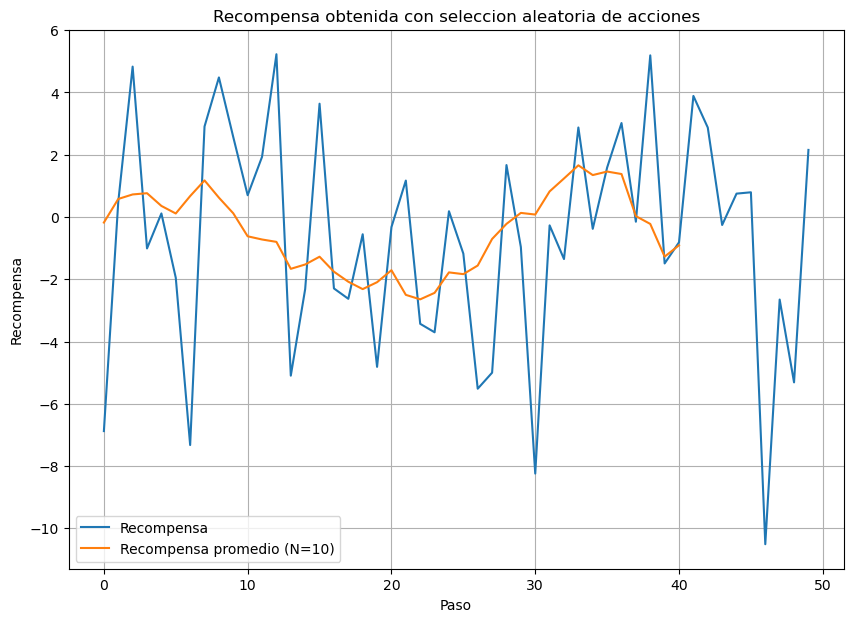

rand_reward
50
promedio rand_reward (N-window)
41


In [7]:
# N window mean
def running_mean(x, N): # parametros: x, N=acciones
    cumsum = np.cumsum(np.insert(x, 0, 0)) 
    return (cumsum[N:] - cumsum[:-N]) / float(N)


# Plot reward
fig=plt.figure(figsize=(10, 7))
plt.plot(rand_reward) #plot recompensa
plt.plot(running_mean(rand_reward, 10)) # plot recompensa promedio
plt.xlabel('Paso')
plt.ylabel('Recompensa')
plt.title('Recompensa obtenida con seleccion aleatoria de acciones')
plt.legend(['Recompensa','Recompensa promedio (N=10)'])
plt.grid(True)
plt.show()

print("rand_reward")
print(len(rand_reward) )
print("promedio rand_reward (N-window)")
print(len(running_mean(rand_reward, 10)) )

# E-GREEDY Method

In [8]:
# def: retorno/promedio de recompensas (promedio "manual") de una accion dada:
# obtiene el promedio de recompensas que da una accion a hasta el time-step n  
# params: a=accion, n=time-step
# return: avg_recompensa=retorno de accion
def prom_recompensa(a,n):
    
    # recompensa promedio
    avg_recompensa = -1
    recompensa_list = []
    # itera sobre el número n de time-steps 
    for i in range(0,n):

        print(i)
        # Se ejecuta la accion a
        
        # calcular recompensa de ejecutar la accion a
        recompensa = bandit_envs.run_env_1(a)
        print("recompensa actual:" + str(recompensa))
        
        # agregar recompensa actual a lista de recompensa
        recompensa_list.append(recompensa)
    
    # obtener retorno=promedio de recompensa de la accion a
    avg_recompensa = np.average(recompensa_list)
    
    print("")
    print("La recompensa promedio de la accion: " +str(a))
    print("Time-step hasta donde se pide la recompensa promedio : "+str(n))
    print("La recompensa promedio: "+str(avg_recompensa))
    
    return avg_recompensa

a=0 #accion=0
n=10 #time-step

prom_recompensa(a,n)  
bandit_envs.reset()

0
recompensa actual:-2.4691507534608825
1
recompensa actual:-1.9292420853836667
2
recompensa actual:-0.77427272323189
3
recompensa actual:0.4768176034458055
4
recompensa actual:3.093829371937022
5
recompensa actual:5.396881792642062
6
recompensa actual:-0.1783497100560461
7
recompensa actual:0.7343602530542234
8
recompensa actual:5.919527522318164
9
recompensa actual:0.5018374545849281

La recompensa promedio de la accion: 0
Time-step hasta donde se pide la recompensa promedio : 10
La recompensa promedio: 1.0772238725849719


In [11]:
# ALGORITMO BASE
n = 20
rand_reward = []
rand_action_selected = []

# Se reinician los entornos
bandit_envs.reset()


# Se ejecutan n pasos
for i in range(0,n):
    # Accion aleatoria
    a = random.randint(0,9)
    # Se ejecuta la accion a
    
    r = bandit_envs.run_env_1(a)
    rand_reward.append(r)
    rand_action_selected.append(a)

print("rand_reward: "+str(rand_reward) )#recompensa
print("rand_action_selected: "+str(rand_action_selected)) # accion seleccionada

rand_reward: [-6.74372476210071, 3.2702745272563853, 3.3451639811512384, 3.1977751960027825, -1.3168801552226719, -3.5807248362067226, 3.4600369565719675, 0.6023910644300619, 0.8043170127141777, 1.3929023932821125, -3.660072220784131, -0.22242691200021425, 2.1236926119767086, 3.837469243442606, -3.3490054292569345, -4.496919543984186, 0.09979175671410612, 4.381766141366585, -0.27746866110008483, -5.549318520057089]
rand_action_selected: [8, 1, 3, 0, 8, 4, 5, 7, 9, 3, 2, 4, 9, 3, 5, 2, 5, 5, 4, 4]


In [12]:
# def: obtiene la accion e-greedy(near-greedy) que maximiza retorno a partir de una lista de acciones (n-bandits), n time-step, eps umbral a.aleatoria, v0 valor inicializacion optimista del retorno, env ambiente/escenario
# params: actions=lista de acciones(n-bandits[0-19]), n=time-step, eps=probabilidad e-greedy (threshold), v0= valor inicializacion optimista, env=ambiente de RL

# return: recompensa_list=lista de recompensa de acciones seleccionadas,retornos_list=lista de retorno,action_selected=lista de acciones seleccionadas,n_select_list= n.veces seleccionada cada accion
def e_greedy(actions,n,eps,v0,env):

    # listas que actualiza el algoritmo
    retornos_list = [] # lista de retorno de las acciones ( incremental)

    n_select_list = [] # lista de n.veces seleccionada cada accion

    # listas de valores que agrega el algoritmo 
    recompensa_list = [] # lista de recompensas

    action_selected = [] # lista de acciones seleccionadas

    # inicializar lista de retornos iniciales con inicializacion optimista
    retornos_list = [v0 for i in range(actions.shape[0])] 
    # inicializar lista de n.veces seleccionada cada accion en 0 para todas las acciones
    n_select_list = np.zeros(10)

    # itera sobre n time-steps 
    for i in range(0,n):
    
            rand_float = np.random.rand() # probabilidad aleatoria entre 0-1
            accion_e_greedy = -1 # accion e-greedy escogida
    
            # escoger accion
            # caso aleatorio(incluida accion greedy): probabilidad aleatoria es menor al umbral/threshold
            if rand_float < eps :
                accion_e_greedy=np.random.choice(actions,replace=True,p=None)
                print("La accion e-greedy escogida: ")
                print(accion_e_greedy)
        
            # caso greedy: escoger accion con retorno maximo
            else:
                accion_e_greedy = actions[retornos_list.index(max(retornos_list))]
                print("La accion e-greedy escogida: ")
                print(accion_e_greedy)
    
            # recompensa actual al escoger accion e-greedy depende del ambiente (env) escogido
            if env==1: 
                recompensa_actual = bandit_envs.run_env_1(accion_e_greedy)
                print("La recompensa actual: "+str(recompensa_actual))
            elif env==2:
                recompensa_actual = bandit_envs.run_env_2(accion_e_greedy)
                print("La recompensa actual: "+str(recompensa_actual))
            elif env==3:
                recompensa_actual = bandit_envs.run_env_3(accion_e_greedy)
                print("La recompensa actual: "+str(recompensa_actual))
                
            # actualizar n.veces escogida de accion escogida
            n_select_list[accion_e_greedy] +=1
    
            # actualizar retorno de accion escogida (retorno eficiente)
            retornos_list[accion_e_greedy] = retornos_list[accion_e_greedy] + (1/(n_select_list[accion_e_greedy]))*(recompensa_actual-retornos_list[accion_e_greedy])     
    
            # agregar recompensa actual a lista de recompensas
            recompensa_list.append(recompensa_actual)
    
            # agregar accion actual a lista de acciones seleccionadas
            action_selected.append(accion_e_greedy)
            print("")
            

    print("Lista de acciones seleccionadas: "+ str(action_selected) )
    print("")
    print("Lista de recompensas: "+ str(recompensa_list) )
    print("Tamaño lista de recompensas: "+str(len(recompensa_list)))
    print("")
    print("Lista de retornos actual: " + str(retornos_list) )
    print("Tamaño lista de retornos actual: "+str(len(retornos_list)))
    print("")
    print("Lista de n.veces escogida de cada accion: "+str(n_select_list) )
    
    return recompensa_list,retornos_list,action_selected,n_select_list


bandit_envs.reset()   


# parametros de algoritmo E-greedy
actions = np.arange(0,10,1) # lista de acciones en bandits
n = 50 # time-step
eps=0.1 # umbral/threshold
v0=5 # valor inicializacion optimista
env=1 # ambiente/escenario de RL
e_greedy(actions,n,eps,v0,env)



La accion e-greedy escogida: 
0
La recompensa actual: -2.952260721666747

La accion e-greedy escogida: 
1
La recompensa actual: 1.7093324449722371

La accion e-greedy escogida: 
2
La recompensa actual: 3.916462188244667

La accion e-greedy escogida: 
3
La recompensa actual: 4.262879659792475

La accion e-greedy escogida: 
4
La recompensa actual: 4.595208170510299

La accion e-greedy escogida: 
5
La recompensa actual: 4.6080633838626355

La accion e-greedy escogida: 
6
La recompensa actual: -0.6836757252434682

La accion e-greedy escogida: 
7
La recompensa actual: -1.7817836435960666

La accion e-greedy escogida: 
8
La recompensa actual: -4.113934317638784

La accion e-greedy escogida: 
1
La recompensa actual: 7.245956530102828

La accion e-greedy escogida: 
9
La recompensa actual: -1.4873101402866558

La accion e-greedy escogida: 
5
La recompensa actual: -0.1649166355274102

La accion e-greedy escogida: 
4
La recompensa actual: -9.17551450762116

La accion e-greedy escogida: 
1
La reco

([-2.952260721666747,
  1.7093324449722371,
  3.916462188244667,
  4.262879659792475,
  4.595208170510299,
  4.6080633838626355,
  -0.6836757252434682,
  -1.7817836435960666,
  -4.113934317638784,
  7.245956530102828,
  -1.4873101402866558,
  -0.1649166355274102,
  -9.17551450762116,
  -0.3405137677515053,
  -2.698207883811467,
  -6.330066522668526,
  -0.9505727619562621,
  1.603315093981339,
  -0.24596295391420397,
  -2.577509250536796,
  1.396589417191291,
  0.7914028495295757,
  1.3958968283433308,
  2.390695443119995,
  1.4897615651948104,
  -3.0250707297779487,
  -2.4866409944191203,
  -2.2080023970348757,
  2.134119826586674,
  3.6793608642954183,
  4.288855551882396,
  3.267114508924536,
  2.971290153789473,
  3.6905066343130875,
  3.4629724309957663,
  -4.626471705409303,
  6.316752387799889,
  2.2135604454377207,
  0.44726309272453735,
  2.793149608247288,
  0.31834627179598307,
  -1.5512637570572285,
  5.391677522302719,
  1.814025061774284,
  8.830713420137721,
  0.798493199

In [10]:
# def: obtiene la accion greedy que maximiza retorno a partir de una lista de acciones (n-bandits), n time-step, v0 valor inicializacion optimista del retorno, env ambiente/escenario
# params: actions=lista de acciones(n-bandits[0-19]), n=time-step, eps=probabilidad e-greedy (threshold), v0= valor inicializacion optimista, env=ambiente de RL

# return: recompensa_list=lista de recompensa de acciones seleccionadas,retornos_list=lista de retorno,action_selected=lista de acciones seleccionadas,n_select_list= n.veces seleccionada cada accion
def greedy(actions,n,v0,env):
    
    # listas que actualiza el algoritmo
    retornos_list = [] # lista de retorno de las acciones ( incremental)

    n_select_list = [] # lista de n.veces seleccionada cada accion

    
    # listas de valores que agrega el algoritmo 
    recompensa_list = [] # lista de recompensas

    action_selected = [] # lista de acciones seleccionadas

    # inicializar lista de retornos iniciales con inicializacion optimista
    retornos_list = [v0 for i in range(actions.shape[0])] 
    # inicializar lista de n.veces seleccionada cada accion en 0 para todas las acciones
    n_select_list = np.zeros(10)

    # itera sobre n time-steps 
    for i in range(0,n):
        
            accion_greedy = -1 # accion e-greedy escogida
            
            # escoger accion: siempre escoge accion greedy, maximiza explotacion (NO exploración)
            # caso greedy: escoger accion con retorno maximo
            accion_greedy = actions[retornos_list.index(max(retornos_list))]
            print("La accion greedy escogida: ")
            print(accion_greedy)
    
            # recompensa actual al escoger accion e-greedy depende del ambiente (env) escogido
            if env==1: 
                recompensa_actual = bandit_envs.run_env_1(accion_greedy)
                print("La recompensa actual: "+str(recompensa_actual))
            elif env==2:
                recompensa_actual = bandit_envs.run_env_2(accion_greedy)
                print("La recompensa actual: "+str(recompensa_actual))
            elif env==3:
                recompensa_actual = bandit_envs.run_env_3(accion_greedy)
                print("La recompensa actual: "+str(recompensa_actual))
                
            # actualizar n.veces escogida de accion escogida
            n_select_list[accion_greedy] +=1
    
            # actualizar retorno de accion escogida (retorno eficiente)
            retornos_list[accion_greedy] = retornos_list[accion_greedy] + (1/(n_select_list[accion_greedy]))*(recompensa_actual-retornos_list[accion_greedy])     
    
            # agregar recompensa actual a lista de recompensas
            recompensa_list.append(recompensa_actual)
    
            # agregar accion actual a lista de acciones seleccionadas
            action_selected.append(accion_greedy)
            print("")
            
            
    print("Lista de acciones seleccionadas: "+ str(action_selected) )
    print("")
    print("Lista de recompensas: "+ str(recompensa_list) )
    print("")
    print("Lista de retornos actual: " + str(retornos_list) )
    print("")
    print("Lista de n.veces escogida de cada accion: "+str(n_select_list) )
    
    
    return recompensa_list,retornos_list,action_selected,n_select_list


bandit_envs.reset()   



# parametros de algoritmo E-greedy
actions = np.arange(0,10,1) # lista de acciones en bandits
n = 50 # time-step
v0=5 # valor inicializacion optimista
env=1 # ambiente/escenario de RL

greedy(actions,n,v0,env)



La accion greedy escogida: 
0
La recompensa actual: 0.0890170272819143

La accion greedy escogida: 
1
La recompensa actual: -0.9949993460615005

La accion greedy escogida: 
2
La recompensa actual: -5.365821220860947

La accion greedy escogida: 
3
La recompensa actual: -2.2776215527447863

La accion greedy escogida: 
4
La recompensa actual: -3.1134975538344003

La accion greedy escogida: 
5
La recompensa actual: 2.812416203929051

La accion greedy escogida: 
6
La recompensa actual: -3.764436475507017

La accion greedy escogida: 
7
La recompensa actual: -0.15809767756594684

La accion greedy escogida: 
8
La recompensa actual: -8.449329109647751

La accion greedy escogida: 
9
La recompensa actual: -0.5727507736418029

La accion greedy escogida: 
5
La recompensa actual: 4.942206138679001

La accion greedy escogida: 
5
La recompensa actual: -2.5572505145409443

La accion greedy escogida: 
5
La recompensa actual: -4.664184909404945

La accion greedy escogida: 
5
La recompensa actual: -2.4279

([0.0890170272819143,
  -0.9949993460615005,
  -5.365821220860947,
  -2.2776215527447863,
  -3.1134975538344003,
  2.812416203929051,
  -3.764436475507017,
  -0.15809767756594684,
  -8.449329109647751,
  -0.5727507736418029,
  4.942206138679001,
  -2.5572505145409443,
  -4.664184909404945,
  -2.427921730448975,
  3.3834943090495773,
  3.513823008079195,
  0.46623294934108916,
  -1.9925475226381435,
  0.605381896655815,
  1.4970055075484496,
  1.9200233920659064,
  -1.5547422496414645,
  0.37540159579143173,
  1.4220991266263834,
  -2.4045390917206575,
  -2.9254935251644416,
  -0.766284626850696,
  5.4582420294109095,
  -0.6766676830389168,
  -4.682639089060769,
  -0.9806952376148164,
  -0.1959230158241232,
  -4.332096832078031,
  -3.7554367317153967,
  -3.2420297048090942,
  -2.6313155654136056,
  4.290269381182261,
  2.3162510502111773,
  1.683868748007336,
  -1.027829461223258,
  5.31141656521822,
  1.4557807812413137,
  0.2868561361036964,
  -2.352395383929932,
  -2.23043312053055,


In [31]:
# def: obtiene la accion greedy que maximiza retorno a partir de una lista de acciones (n-bandits), n time-step, v0 valor inicializacion optimista del retorno, env ambiente/escenario
# params: actions=lista de acciones(n-bandits[0-19]), n=time-step, eps=probabilidad e-greedy (threshold), v0= valor inicializacion optimista, env=ambiente de RL

# return: recompensa_list=lista de recompensa de acciones seleccionadas,retornos_list=lista de retorno,action_selected=lista de acciones seleccionadas,n_select_list= n.veces seleccionada cada accion
def seleccion_opt(actions,n,v0,env,accion_opt):
    
    # listas que actualiza el algoritmo
    retornos_list = [] # lista de retorno de las acciones ( incremental)

    n_select_list = [] # lista de n.veces seleccionada cada accion
    
    
    # listas de valores que agrega el algoritmo 
    recompensa_list = [] # lista de recompensas

    action_selected = [] # lista de acciones seleccionadas

    # inicializar lista de retornos iniciales con inicializacion optimista
    retornos_list = [v0 for i in range(actions.shape[0])] 
    # inicializar lista de n.veces seleccionada cada accion en 0 para todas las acciones
    n_select_list = np.zeros(10)

    # itera sobre n time-steps 
    for i in range(0,n):
        

            # escoger accion: siempre escoge acción óptima
            # caso óptimo: escoger accion óptima conocida 
            print("La acción óptima: "+str(accion_opt) )
            
            # recompensa actual al escoger accion óptima SIEMPRE depende del ambiente (env) escogido
            if env==1: 
                recompensa_actual = bandit_envs.run_env_1(accion_opt)
                print("La recompensa actual: "+str(recompensa_actual))
            elif env==2:
                recompensa_actual = bandit_envs.run_env_2(accion_opt)
                print("La recompensa actual: "+str(recompensa_actual))
            elif env==3:
                recompensa_actual = bandit_envs.run_env_3(accion_opt)
                print("La recompensa actual: "+str(recompensa_actual))
                
            # actualizar n.veces escogida de accion escogida
            n_select_list[accion_opt] +=1
    
            # actualizar retorno de accion escogida (retorno eficiente)
            retornos_list[accion_opt] = retornos_list[accion_opt] + (1/(n_select_list[accion_opt]))*(recompensa_actual-retornos_list[accion_opt])     
    
            # agregar recompensa actual a lista de recompensas
            recompensa_list.append(recompensa_actual)
    
            # agregar accion actual a lista de acciones seleccionadas
            action_selected.append(accion_opt)
            print("")
            
            
    print("Lista de acciones seleccionadas: "+ str(action_selected) )
    print("")
    print("Lista de recompensas: "+ str(recompensa_list) )
    print("")
    print("Lista de retornos actual: " + str(retornos_list) )
    print("")
    print("Lista de n.veces escogida de cada accion: "+str(n_select_list) )
    
    
    return recompensa_list,retornos_list,action_selected,n_select_list


bandit_envs.reset()   



# parametros de algoritmo E-greedy
actions = np.arange(0,10,1) # lista de acciones en bandits
n = 50 # time-step
v0=0 # valor inicializacion optimista
env=1 # ambiente/escenario de RL
accion_opt=3

seleccion_opt(actions,n,v0,env,accion_opt)


La acción óptima: 3
La recompensa actual: 3.263617583713845

La acción óptima: 3
La recompensa actual: 4.773434178549296

La acción óptima: 3
La recompensa actual: 1.521794154530188

La acción óptima: 3
La recompensa actual: 3.9159863981344762

La acción óptima: 3
La recompensa actual: 2.24966717928704

La acción óptima: 3
La recompensa actual: 1.6907528038808908

La acción óptima: 3
La recompensa actual: 2.2417402005131066

La acción óptima: 3
La recompensa actual: 5.425123732351877

La acción óptima: 3
La recompensa actual: 5.2349170511829435

La acción óptima: 3
La recompensa actual: -0.5371720028855926

La acción óptima: 3
La recompensa actual: 5.61441064193875

La acción óptima: 3
La recompensa actual: 5.654382089612245

La acción óptima: 3
La recompensa actual: 2.7035281858988984

La acción óptima: 3
La recompensa actual: 0.9008451122957046

La acción óptima: 3
La recompensa actual: 6.135538540339718

La acción óptima: 3
La recompensa actual: 0.5053628800346388

La acción óptima:

([3.263617583713845,
  4.773434178549296,
  1.521794154530188,
  3.9159863981344762,
  2.24966717928704,
  1.6907528038808908,
  2.2417402005131066,
  5.425123732351877,
  5.2349170511829435,
  -0.5371720028855926,
  5.61441064193875,
  5.654382089612245,
  2.7035281858988984,
  0.9008451122957046,
  6.135538540339718,
  0.5053628800346388,
  3.205541056097366,
  1.3285983248546627,
  9.09841184554124,
  8.401874192207064,
  9.433627744101285,
  6.4784854819357385,
  7.919160126345112,
  5.074369139579172,
  3.248260196262036,
  -1.2686830714482311,
  3.3880224000154393,
  6.066858483079632,
  4.69823082797655,
  5.767064697608845,
  1.4543862471162994,
  8.441032214246759,
  -2.116492314440294,
  0.1504736014964645,
  5.647543339534521,
  1.9684821341379783,
  1.6844170095964297,
  -1.8714847573463982,
  4.478692437928758,
  5.799759019027989,
  0.7562281843799425,
  -0.07616548176690774,
  1.5855055997309369,
  3.178039374705273,
  7.318565678120981,
  3.5700520257758743,
  -2.375394

# Métricas de Evaluación

# Funciones

In [14]:
# Función promedio: N window mean
def running_mean(x, N): # parametros: x vector, N=acciones
    cumsum = np.cumsum(np.insert(x, 0, 0)) 
    return (cumsum[N:] - cumsum[:-N]) / float(N)


In [ ]:
# parametros de algoritmo E-greedy
actions = np.arange(0,10,1) # lista de acciones en bandits
n = 50 # time-step
eps=0.1 # umbral/threshold
v0=5 # valor inicializacion optimista
env=1 # ambiente/escenario de RL

# aplicar método e-greedy, obtener listas de recompensa, retorno, acciones seleccionadas y n.veces de acciones seleccionadas
recompensa_list,retornos_list,action_selected,n_select_list = e_greedy(actions,n,eps,v0,env)

N=10 #acciones
promedio_recompensa = running_mean(recompensa_list, N)

print("")
print("Recompensa: "+str(recompensa_list))
print("")
print("Promedio de Recompensa: "+str(promedio_recompensa))

print("Recompensa len: "+str(len(recompensa_list)) )
print("Promedio de Recompensa len: "+str(len(promedio_recompensa)) )

# Recompensa Promedio Ponderada

La accion e-greedy escogida: 
0
La recompensa actual: -2.5387863555440044

La accion e-greedy escogida: 
1
La recompensa actual: 1.4370422825182931

La accion e-greedy escogida: 
2
La recompensa actual: -6.997761183226073

La accion e-greedy escogida: 
3
La recompensa actual: -1.418786372722717

La accion e-greedy escogida: 
4
La recompensa actual: -0.6802296395179953

La accion e-greedy escogida: 
5
La recompensa actual: -0.6939863293195933

La accion e-greedy escogida: 
6
La recompensa actual: 1.9530588601261742

La accion e-greedy escogida: 
7
La recompensa actual: -4.936002623120712

La accion e-greedy escogida: 
8
La recompensa actual: -0.5912026307502394

La accion e-greedy escogida: 
9
La recompensa actual: 0.3986712782434616

La accion e-greedy escogida: 
6
La recompensa actual: -0.5540738853341112

La accion e-greedy escogida: 
1
La recompensa actual: 7.910522482246461

La accion e-greedy escogida: 
1
La recompensa actual: 0.839149388370818

La accion e-greedy escogida: 
1
La 

La accion e-greedy escogida: 
6
La recompensa actual: 3.833907354419891

La accion e-greedy escogida: 
3
La recompensa actual: 3.9433569713336714

La accion e-greedy escogida: 
3
La recompensa actual: -3.075625398163424

La accion e-greedy escogida: 
3
La recompensa actual: 1.4490935729379084

La accion e-greedy escogida: 
3
La recompensa actual: 4.392847313084623

La accion e-greedy escogida: 
3
La recompensa actual: -0.46759822117505845

La accion e-greedy escogida: 
3
La recompensa actual: 0.380651979386188

La accion e-greedy escogida: 
3
La recompensa actual: 6.815904893916352

La accion e-greedy escogida: 
3
La recompensa actual: 1.0292701253931602

La accion e-greedy escogida: 
1
La recompensa actual: 3.023142301379494

La accion e-greedy escogida: 
3
La recompensa actual: 4.640692369757945

La accion e-greedy escogida: 
3
La recompensa actual: 6.393539446431991

La accion e-greedy escogida: 
3
La recompensa actual: 6.5321053373647615

La accion e-greedy escogida: 
3
La recompen

La accion e-greedy escogida: 
2
La recompensa actual: -7.779043079845746

La accion e-greedy escogida: 
1
La recompensa actual: 6.047991421099477

La accion e-greedy escogida: 
3
La recompensa actual: -3.766755202824966

La accion e-greedy escogida: 
3
La recompensa actual: 2.6675717106576933

La accion e-greedy escogida: 
3
La recompensa actual: -1.357646101504756

La accion e-greedy escogida: 
3
La recompensa actual: 2.2896996409110812

La accion e-greedy escogida: 
5
La recompensa actual: 6.82036847174633

La accion e-greedy escogida: 
3
La recompensa actual: -0.31841243393014906

La accion e-greedy escogida: 
3
La recompensa actual: 0.22024780696389135

La accion e-greedy escogida: 
3
La recompensa actual: 2.519552660341768

La accion e-greedy escogida: 
3
La recompensa actual: 4.945297304648864

La accion e-greedy escogida: 
3
La recompensa actual: 8.02471181370187

La accion e-greedy escogida: 
3
La recompensa actual: 1.2659613811951034

La accion e-greedy escogida: 
3
La recompe

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



La accion e-greedy escogida: 
4
La recompensa actual: -6.162184693202395

La accion e-greedy escogida: 
3
La recompensa actual: 4.569956815985037

La accion e-greedy escogida: 
3
La recompensa actual: 1.4856849331297246

La accion e-greedy escogida: 
3
La recompensa actual: 3.4405921104228643

La accion e-greedy escogida: 
3
La recompensa actual: -4.400645440902789

La accion e-greedy escogida: 
3
La recompensa actual: -4.108453531918116

La accion e-greedy escogida: 
3
La recompensa actual: 3.9751978561868917

La accion e-greedy escogida: 
3
La recompensa actual: -0.43202747640663786

La accion e-greedy escogida: 
3
La recompensa actual: 6.31514090818608

La accion e-greedy escogida: 
3
La recompensa actual: 2.4880555616556563

La accion e-greedy escogida: 
3
La recompensa actual: 2.684738539897021

La accion e-greedy escogida: 
3
La recompensa actual: 4.07625846382445

La accion e-greedy escogida: 
3
La recompensa actual: -0.39995415979948534

La accion e-greedy escogida: 
0
La recom

La accion e-greedy escogida: 
7
La recompensa actual: -3.0344999274287696

La accion e-greedy escogida: 
3
La recompensa actual: 4.736754104827329

La accion e-greedy escogida: 
3
La recompensa actual: -0.8977016200135188

La accion e-greedy escogida: 
3
La recompensa actual: 9.192434250542485

La accion e-greedy escogida: 
3
La recompensa actual: 8.903363407002155

La accion e-greedy escogida: 
3
La recompensa actual: 6.184264634837991

La accion e-greedy escogida: 
3
La recompensa actual: 5.287280429113471

La accion e-greedy escogida: 
3
La recompensa actual: 6.638365427671793

La accion e-greedy escogida: 
3
La recompensa actual: 5.266334425545056

La accion e-greedy escogida: 
3
La recompensa actual: 4.781903333265051

La accion e-greedy escogida: 
3
La recompensa actual: 3.7793718278937103

La accion e-greedy escogida: 
3
La recompensa actual: 7.425382399322558

La accion e-greedy escogida: 
3
La recompensa actual: -2.1200346961490637

La accion e-greedy escogida: 
3
La recompens

La accion e-greedy escogida: 
4
La recompensa actual: -5.335630327268936

La accion e-greedy escogida: 
3
La recompensa actual: -0.7650299509757645

La accion e-greedy escogida: 
3
La recompensa actual: 1.9569722201669837

La accion e-greedy escogida: 
3
La recompensa actual: 6.984918964143981

La accion e-greedy escogida: 
3
La recompensa actual: -1.4591394682513799

La accion e-greedy escogida: 
3
La recompensa actual: 4.4148863963629585

La accion e-greedy escogida: 
6
La recompensa actual: -1.753041166079547

La accion e-greedy escogida: 
3
La recompensa actual: 8.226131847097117

La accion e-greedy escogida: 
3
La recompensa actual: 6.2472976497397275

La accion e-greedy escogida: 
3
La recompensa actual: 9.731263834554767

La accion e-greedy escogida: 
3
La recompensa actual: 1.2157329981789253

La accion e-greedy escogida: 
3
La recompensa actual: 2.442908061754551

La accion e-greedy escogida: 
3
La recompensa actual: 6.567755622012793

La accion e-greedy escogida: 
3
La recomp

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



La accion e-greedy escogida: 
0
La recompensa actual: 1.1500163217815422

La accion e-greedy escogida: 
1
La recompensa actual: 3.180611276179011

La accion e-greedy escogida: 
2
La recompensa actual: -1.8269950857122494

La accion e-greedy escogida: 
3
La recompensa actual: 0.4951722411148425

La accion e-greedy escogida: 
4
La recompensa actual: 3.8283887001937034

La accion e-greedy escogida: 
5
La recompensa actual: 0.8781203849776794

La accion e-greedy escogida: 
8
La recompensa actual: -4.385769602368509

La accion e-greedy escogida: 
6
La recompensa actual: -2.542247987449578

La accion e-greedy escogida: 
7
La recompensa actual: -0.49590793102564534

La accion e-greedy escogida: 
9
La recompensa actual: -2.562317377420896

La accion e-greedy escogida: 
4
La recompensa actual: -1.9283654317011851

La accion e-greedy escogida: 
1
La recompensa actual: -1.2558526985935121

La accion e-greedy escogida: 
0
La recompensa actual: 0.3375729152603585

La accion e-greedy escogida: 
1
La

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



La accion e-greedy escogida: 
7
La recompensa actual: 0.9527716340838162

La accion e-greedy escogida: 
1
La recompensa actual: -2.1821940403836146

La accion e-greedy escogida: 
1
La recompensa actual: 1.6755344302709045

La accion e-greedy escogida: 
1
La recompensa actual: 0.029044891596236022

La accion e-greedy escogida: 
1
La recompensa actual: 6.01076222251575

La accion e-greedy escogida: 
1
La recompensa actual: 6.370343104693643

La accion e-greedy escogida: 
1
La recompensa actual: 2.0715389479741253

La accion e-greedy escogida: 
4
La recompensa actual: -4.714239868740589

La accion e-greedy escogida: 
1
La recompensa actual: 0.7990762985664219

La accion e-greedy escogida: 
1
La recompensa actual: 3.6047222981631872

La accion e-greedy escogida: 
1
La recompensa actual: 1.0665942826345316

La accion e-greedy escogida: 
1
La recompensa actual: 4.243431468827467

La accion e-greedy escogida: 
1
La recompensa actual: 5.660820956813007

La accion e-greedy escogida: 
3
La recom

La accion e-greedy escogida: 
5
La recompensa actual: -2.0065374411187284

La accion e-greedy escogida: 
3
La recompensa actual: -0.5148656604072426

La accion e-greedy escogida: 
3
La recompensa actual: 3.278178563134903

La accion e-greedy escogida: 
3
La recompensa actual: 2.3098446417005567

La accion e-greedy escogida: 
3
La recompensa actual: 5.236179030707082

La accion e-greedy escogida: 
3
La recompensa actual: 4.621433016134629

La accion e-greedy escogida: 
3
La recompensa actual: 1.2401074059412527

La accion e-greedy escogida: 
7
La recompensa actual: -1.6710808380810052

La accion e-greedy escogida: 
4
La recompensa actual: -1.0144202481333253

La accion e-greedy escogida: 
3
La recompensa actual: 3.635026344872146

La accion e-greedy escogida: 
3
La recompensa actual: 2.047890004687626

La accion e-greedy escogida: 
3
La recompensa actual: 1.516027124606067

La accion e-greedy escogida: 
3
La recompensa actual: 4.05516008096648

La accion e-greedy escogida: 
3
La recompe

La accion e-greedy escogida: 
9
La recompensa actual: 0.39288277673600014

La accion e-greedy escogida: 
1
La recompensa actual: 0.8895112624707894

La accion e-greedy escogida: 
2
La recompensa actual: -9.68641799287536

La accion e-greedy escogida: 
3
La recompensa actual: 7.304399628623013

La accion e-greedy escogida: 
3
La recompensa actual: 3.5717057800607375

La accion e-greedy escogida: 
3
La recompensa actual: 0.5042737989825983

La accion e-greedy escogida: 
4
La recompensa actual: -5.917971049676777

La accion e-greedy escogida: 
6
La recompensa actual: 4.1568518556176

La accion e-greedy escogida: 
8
La recompensa actual: -3.880872053619414

La accion e-greedy escogida: 
7
La recompensa actual: -4.579099681300533

La accion e-greedy escogida: 
5
La recompensa actual: 0.047590369255887555

La accion e-greedy escogida: 
6
La recompensa actual: 1.026836459603619

La accion e-greedy escogida: 
3
La recompensa actual: 5.393693153978128

La accion e-greedy escogida: 
3
La recompe

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



La accion e-greedy escogida: 
9
La recompensa actual: 2.8987598938752726

La accion e-greedy escogida: 
1
La recompensa actual: 5.152749520948793

La accion e-greedy escogida: 
1
La recompensa actual: 3.6919421584853502

La accion e-greedy escogida: 
1
La recompensa actual: 0.8312582692717847

La accion e-greedy escogida: 
1
La recompensa actual: 4.295277947430982

La accion e-greedy escogida: 
1
La recompensa actual: 5.174862456687123

La accion e-greedy escogida: 
1
La recompensa actual: -1.0694017776978184

La accion e-greedy escogida: 
1
La recompensa actual: -4.098835491671298

La accion e-greedy escogida: 
1
La recompensa actual: 0.7137207453742931

La accion e-greedy escogida: 
1
La recompensa actual: 7.156454570197542

La accion e-greedy escogida: 
6
La recompensa actual: -0.7764300517581021

La accion e-greedy escogida: 
1
La recompensa actual: 0.7143043759670404

La accion e-greedy escogida: 
1
La recompensa actual: -1.2338238001193866

La accion e-greedy escogida: 
1
La reco

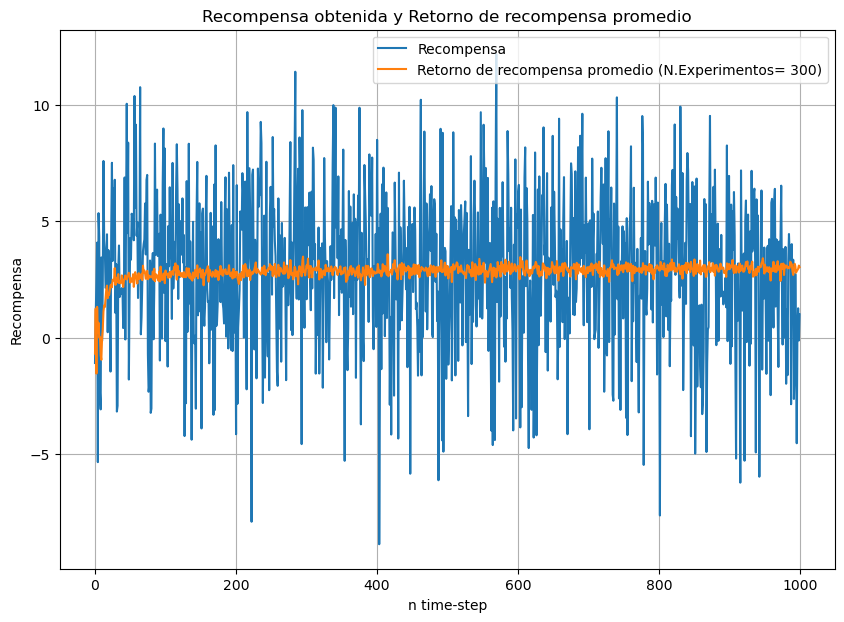

[-0.6857228256337572,
 1.2536802513645373,
 -1.5386775999386744,
 1.3260751200726593,
 0.21531465891807425,
 0.6447896858900445,
 0.007617207129839626,
 0.028898204058322417,
 -0.7444143036523005,
 -0.9488705547480772,
 -0.02174923255865914,
 0.35158683988708267,
 1.1329637095131855,
 1.3933719774654105,
 1.3198360503342288,
 1.6930173466029435,
 2.079407982472879,
 2.237780341056289,
 1.6983132913818015,
 1.9096412849019782,
 1.835637829621901,
 2.032146717173449,
 2.248187543362942,
 2.283472096102813,
 2.1664609158066845,
 2.49245150120567,
 2.459710829414844,
 2.490722672354668,
 2.9921451705083904,
 2.2719609763815907,
 2.5627692387376935,
 2.3744599243745554,
 2.582119116100031,
 2.733801278478041,
 2.3497254454369565,
 2.422685458322392,
 2.3407575458592027,
 2.382709584238366,
 2.6775965220340407,
 2.3865522911787345,
 2.1778372922059304,
 2.4464984899455406,
 2.5335592003162297,
 2.6756865169058823,
 2.55510256756405,
 2.5025453285395516,
 2.6231012037156076,
 2.71075565890647

In [29]:
### parámetros método e-greedy
actions = np.arange(0,10,1) # lista de acciones en bandits
n = 1000 # time-step (iteraciones)
eps=0.1 # umbral/threshold
v0=5 # valor inicializacion optimista
env=1 # ambiente/escenario de RL


# def: Plot recompensa promedio ponderada N veces
# params: N=veces que se repite el experimento/ponderado

# returns: recompensa_promedio_ponderada= lista de "retorno" de recompensa promedio ponderada
def recompensa_promedio_ponderada (N):
    
    # inicializar retorno de recompensa promedio con tamaño de vector de retorno
    retornos_recompensa_prom_list = np.zeros(n)
    
    # itera sobre N veces que repite el experimento
    for i in range(1,N):
        
        # resolver n-bandits con método e-greedy, obtener listas de recompensa, retorno, acciones seleccionadas y n.veces de acciones seleccionadas
        recompensa_list,retornos_list,action_selected,n_select_list = e_greedy(actions,n,eps,v0,env)
        print("Recompensa actual: "+str(recompensa_list))
        
        # agregar elementos a la lista de retorno de recompensa promedio (incremental-asignación por lista j )
        retornos_recompensa_prom_list = [retornos_recompensa_prom_list[j] + (1/i)*(recompensa_list[j]-retornos_recompensa_prom_list[j]) for j in range(len(recompensa_list))]     
        
        # Se reinician los ambientes/entornos en cada experimento
        bandit_envs.reset()
    
    print(retornos_recompensa_prom_list)

    # Plot recompensa promedio ponderada  
    fig=plt.figure(figsize=(10, 7))    
    
    plt.plot(recompensa_list) # plot de recompensa en el último experimento
    plt.plot(retornos_recompensa_prom_list) # plot "retorno" de recompensa promedio ponderada 
    
    
    # labels
    plt.xlabel('n time-step')
    plt.ylabel('Recompensa')
    plt.title('Recompensa obtenida y Retorno de recompensa promedio')
    plt.legend(['Recompensa','Retorno de recompensa promedio (N.Experimentos= '+str(N)+")"])
    plt.grid(True)
    plt.show()
    
    return retornos_recompensa_prom_list


# numero de experimentos (n.ponderado)
N=300

recompensa_promedio_ponderada (N)


# Recompensa esperada ponderada (Retorno ponderado)

In [24]:


### parámetros método e-greedy
actions = np.arange(0,10,1) # lista de acciones en bandits
n = 1000 # time-step (iteraciones)
eps=0.1 # umbral/threshold
v0=5 # valor inicializacion optimista
env=1 # ambiente/escenario de RL


# def: Plot retorno (recompensa esperada) ponderada N veces
# params: N=veces que se repite el experimento/ponderado

# returns: recompensa esperada/promediada ponderada= lista de retorno ponderado 
def retorno_ponderado (N):
    
    # inicializar retorno de recompensa promedio con tamaño de vector de retorno
    retorno_ponderado_list = np.zeros(n)
    
    # itera sobre N veces que repite el experimento
    for i in range(1,N):
        
        # resolver n-bandits con método e-greedy, obtener listas de recompensa, retorno, acciones seleccionadas y n.veces de acciones seleccionadas
        recompensa_list,retornos_list,action_selected,n_select_list = e_greedy(actions,n,eps,v0,env)
        print("Retorno actual : "+str(retornos_list))
        
        
        # agregar elementos a la lista de retorno de recompensa promedio (incremental-asignación por lista j )
        retorno_ponderado_list = [retorno_ponderado_list[j] + (1/i)*(retornos_list[j]-retorno_ponderado_list[j]) for j in range(1,n) ]     
        
        # Se reinician los ambientes/entornos en cada experimento
        bandit_envs.reset()
    
    print(retorno_ponderado_list)

    # Plot recompensa promedio ponderada  
    fig=plt.figure(figsize=(10, 7))    
    
    plt.plot(retornos_list) # plot de retorno actual (último experimento)
    plt.plot(retorno_ponderado_list) # plot "retorno" ponderado 
    
    
    # labels
    plt.xlabel('n time-step')
    plt.ylabel('Retorno')
    plt.title('Retorno actual y Retorno ponderado')
    plt.legend(['Retorno actual','Retorno ponderado (N.Experimentos= '+str(N)+")"])
    plt.grid(True)
    plt.show()
    
    return retorno_ponderado_list


# numero de experimentos (n.ponderado)
N=300

retorno_ponderado (N)

La accion e-greedy escogida: 
0
La recompensa actual: 0.6172724722667621

La accion e-greedy escogida: 
0
La recompensa actual: 4.318453819323847

La accion e-greedy escogida: 
1
La recompensa actual: -3.22388377179555

La accion e-greedy escogida: 
2
La recompensa actual: -6.8918569269786625

La accion e-greedy escogida: 
3
La recompensa actual: 0.5349785979457082

La accion e-greedy escogida: 
4
La recompensa actual: 0.23384688254727082

La accion e-greedy escogida: 
5
La recompensa actual: 3.4879314063518776

La accion e-greedy escogida: 
8
La recompensa actual: -5.0693011507239465

La accion e-greedy escogida: 
6
La recompensa actual: 2.1237425996627404

La accion e-greedy escogida: 
7
La recompensa actual: -3.950504219034613

La accion e-greedy escogida: 
9
La recompensa actual: -5.434571002325939

La accion e-greedy escogida: 
5
La recompensa actual: 3.7456612548688306

La accion e-greedy escogida: 
5
La recompensa actual: -0.5426009466493423

La accion e-greedy escogida: 
0
La r

IndexError: list index out of range

# Porcentaje Acción Óptima Ponderada

La accion e-greedy escogida: 
0
La recompensa actual: -1.1276218497422446

La accion e-greedy escogida: 
1
La recompensa actual: 4.287181380921074

La accion e-greedy escogida: 
2
La recompensa actual: -2.856979439895354

La accion e-greedy escogida: 
3
La recompensa actual: 4.79131329021898

La accion e-greedy escogida: 
4
La recompensa actual: -3.5264959846228887

La accion e-greedy escogida: 
1
La recompensa actual: -5.052041675893983

La accion e-greedy escogida: 
5
La recompensa actual: 1.8541324775212238

La accion e-greedy escogida: 
6
La recompensa actual: 2.461005890536421

La accion e-greedy escogida: 
7
La recompensa actual: -4.287533127746579

La accion e-greedy escogida: 
8
La recompensa actual: 0.10115064218380465

La accion e-greedy escogida: 
9
La recompensa actual: -1.4028377251078221

La accion e-greedy escogida: 
8
La recompensa actual: -4.630297117631651

La accion e-greedy escogida: 
3
La recompensa actual: 1.9450848969635524

La accion e-greedy escogida: 
3
La rec

Porcentaje accion optima actual: [0.         0.5        0.33333333 0.25       0.2        0.16666667
 0.14285714 0.125      0.11111111 0.1        0.09090909 0.08333333
 0.07692308 0.14285714 0.2        0.25       0.29411765 0.33333333
 0.36842105 0.4        0.42857143 0.45454545 0.43478261 0.45833333
 0.48       0.5        0.51851852 0.53571429 0.55172414 0.56666667
 0.58064516 0.59375    0.60606061 0.61764706 0.62857143 0.63888889
 0.62162162 0.63157895 0.64102564 0.625      0.63414634 0.64285714
 0.65116279 0.65909091 0.66666667 0.65217391 0.63829787 0.64583333
 0.65306122 0.64       0.64705882 0.65384615 0.66037736 0.66666667
 0.65454545 0.66071429 0.66666667 0.67241379 0.6779661  0.68333333
 0.68852459 0.69354839 0.6984127  0.703125   0.70769231 0.71212121
 0.71641791 0.72058824 0.72463768 0.72857143 0.73239437 0.73611111
 0.73972603 0.74324324 0.74666667 0.75       0.75324675 0.75641026
 0.75949367 0.7625     0.7654321  0.75609756 0.74698795 0.75
 0.75294118 0.75581395 0.75862069 0

Porcentaje accion optima actual: [0.         0.         0.         0.         0.2        0.16666667
 0.14285714 0.125      0.22222222 0.2        0.18181818 0.16666667
 0.23076923 0.28571429 0.26666667 0.3125     0.35294118 0.38888889
 0.42105263 0.45       0.42857143 0.45454545 0.47826087 0.5
 0.52       0.53846154 0.55555556 0.57142857 0.5862069  0.6
 0.61290323 0.625      0.63636364 0.64705882 0.65714286 0.66666667
 0.67567568 0.68421053 0.69230769 0.675      0.68292683 0.69047619
 0.69767442 0.68181818 0.68888889 0.69565217 0.70212766 0.70833333
 0.71428571 0.72       0.7254902  0.73076923 0.71698113 0.72222222
 0.72727273 0.73214286 0.73684211 0.74137931 0.74576271 0.75
 0.75409836 0.75806452 0.76190476 0.765625   0.76923077 0.77272727
 0.7761194  0.76470588 0.76811594 0.77142857 0.77464789 0.77777778
 0.78082192 0.77027027 0.77333333 0.77631579 0.77922078 0.78205128
 0.78481013 0.7875     0.79012346 0.79268293 0.79518072 0.79761905
 0.8        0.80232558 0.8045977  0.80681818 0.80

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



La accion e-greedy escogida: 
2
La recompensa actual: -3.4443918389044663

La accion e-greedy escogida: 
3
La recompensa actual: 3.77140745948833

La accion e-greedy escogida: 
3
La recompensa actual: 3.157099812734002

La accion e-greedy escogida: 
3
La recompensa actual: 7.117995104603048

La accion e-greedy escogida: 
0
La recompensa actual: 2.8816944512269957

La accion e-greedy escogida: 
3
La recompensa actual: 4.018100074827026

La accion e-greedy escogida: 
3
La recompensa actual: 0.8880397460703313

La accion e-greedy escogida: 
6
La recompensa actual: -4.565828236198404

La accion e-greedy escogida: 
3
La recompensa actual: 2.6187720589287213

La accion e-greedy escogida: 
3
La recompensa actual: 5.880405077144005

La accion e-greedy escogida: 
8
La recompensa actual: -4.664423321266054

La accion e-greedy escogida: 
3
La recompensa actual: 0.5825577897939929

La accion e-greedy escogida: 
3
La recompensa actual: 3.8931329886878654

La accion e-greedy escogida: 
3
La recompen

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



La accion e-greedy escogida: 
0
La recompensa actual: -2.7376545884202006

La accion e-greedy escogida: 
1
La recompensa actual: 4.631730801749691

La accion e-greedy escogida: 
2
La recompensa actual: -9.340333106176391

La accion e-greedy escogida: 
3
La recompensa actual: 1.2805059239948444

La accion e-greedy escogida: 
4
La recompensa actual: -2.8262431135668713

La accion e-greedy escogida: 
5
La recompensa actual: 3.8423609333752986

La accion e-greedy escogida: 
6
La recompensa actual: -2.4603218222886216

La accion e-greedy escogida: 
7
La recompensa actual: -2.2705623207072216

La accion e-greedy escogida: 
8
La recompensa actual: 1.7684654522090255

La accion e-greedy escogida: 
9
La recompensa actual: -0.8598095828484604

La accion e-greedy escogida: 
1
La recompensa actual: 2.5963586981143876

La accion e-greedy escogida: 
5
La recompensa actual: -0.11633405449301126

La accion e-greedy escogida: 
1
La recompensa actual: 4.1550108791960465

La accion e-greedy escogida: 
1


La accion e-greedy escogida: 
2
La recompensa actual: -4.50350149975862

La accion e-greedy escogida: 
3
La recompensa actual: 3.1968567796195027

La accion e-greedy escogida: 
3
La recompensa actual: 4.599668629347996

La accion e-greedy escogida: 
3
La recompensa actual: 7.942085967232627

La accion e-greedy escogida: 
3
La recompensa actual: 4.931174304510741

La accion e-greedy escogida: 
3
La recompensa actual: 7.668756078388737

La accion e-greedy escogida: 
3
La recompensa actual: 2.568105838267028

La accion e-greedy escogida: 
3
La recompensa actual: 3.9790254924382884

La accion e-greedy escogida: 
3
La recompensa actual: 2.8800905699632233

La accion e-greedy escogida: 
3
La recompensa actual: 2.7527309774292013

La accion e-greedy escogida: 
3
La recompensa actual: 1.1260970880285215

La accion e-greedy escogida: 
3
La recompensa actual: -0.8172081123915738

La accion e-greedy escogida: 
3
La recompensa actual: -5.748388710218316

La accion e-greedy escogida: 
3
La recompen

La accion e-greedy escogida: 
6
La recompensa actual: -0.40261364190498966

La accion e-greedy escogida: 
5
La recompensa actual: 2.644814425187775

La accion e-greedy escogida: 
7
La recompensa actual: 0.3474525788187346

La accion e-greedy escogida: 
8
La recompensa actual: -3.073412011664481

La accion e-greedy escogida: 
0
La recompensa actual: 7.824951618439867

La accion e-greedy escogida: 
0
La recompensa actual: 1.106299306413371

La accion e-greedy escogida: 
0
La recompensa actual: -3.18885623246067

La accion e-greedy escogida: 
3
La recompensa actual: 5.199998234719416

La accion e-greedy escogida: 
3
La recompensa actual: 6.550015748299508

La accion e-greedy escogida: 
3
La recompensa actual: 4.4200664670907255

La accion e-greedy escogida: 
3
La recompensa actual: -0.18852760581606365

La accion e-greedy escogida: 
3
La recompensa actual: 6.9640600296001365

La accion e-greedy escogida: 
3
La recompensa actual: 1.5481064154633724

La accion e-greedy escogida: 
3
La recom

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



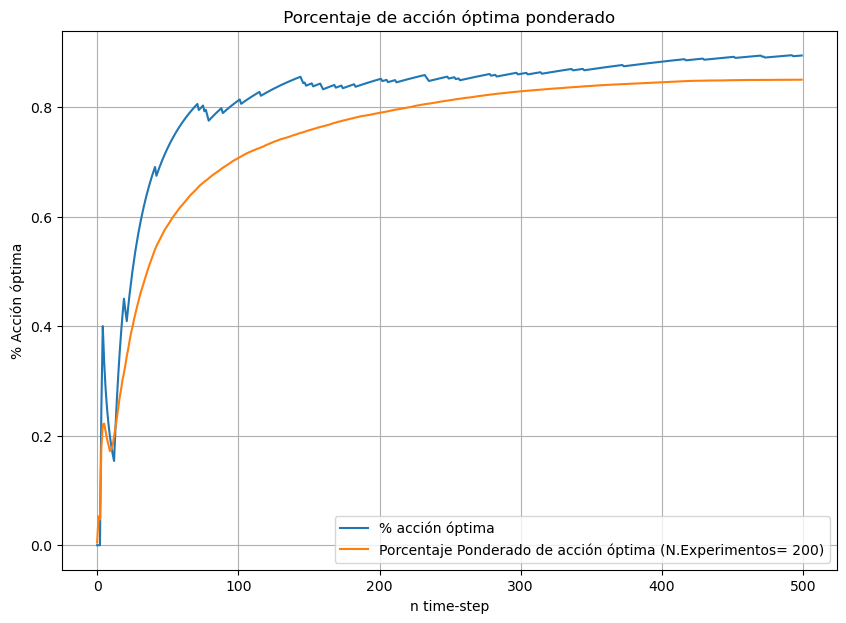

[0.005025125628140702,
 0.05276381909547739,
 0.04690117252931322,
 0.17839195979899503,
 0.22010050251256288,
 0.22194304857621444,
 0.20818377602297194,
 0.19409547738693467,
 0.1836962590731434,
 0.17185929648241197,
 0.17496573777980823,
 0.18216080402010043,
 0.19829918824893703,
 0.21536252692031588,
 0.23249581239530992,
 0.2515703517587938,
 0.27017440141885896,
 0.28503629257398105,
 0.3023009785770962,
 0.3145728643216078,
 0.32878679109834885,
 0.34536317953403384,
 0.3580948219357657,
 0.3733249581239532,
 0.38713567839195995,
 0.3977580208735986,
 0.4107574911595011,
 0.42193108399138546,
 0.4326806446023219,
 0.4428810720268006,
 0.453396012319663,
 0.46262562814070346,
 0.470382214100807,
 0.4791605084244755,
 0.48743718592964824,
 0.49581239530988286,
 0.503734890669564,
 0.5115048928854803,
 0.5186187346991367,
 0.5255025125628141,
 0.5326633165829147,
 0.5399617133285474,
 0.5461026060535239,
 0.551164915486523,
 0.556672250139587,
 0.5613939261525018,
 0.566449267614

In [28]:
### parámetros método e-greedy
actions = np.arange(0,10,1) # lista de acciones en bandits
n = 500 # time-step (iteraciones)
eps=0.1 # umbral/threshold
v0=5 # valor inicializacion optimista
env=1 # ambiente/escenario de RL


# def: Plot recompensa promedio ponderada N veces
# params: N=veces que se repite el experimento/ponderado

# returns: porcentaje_accion_opt_ponderado= porcentaje de acción óptima ponderado N veces

def porcentaje_accion_opt_ponderado (N):
    
    # inicializar retorno de recompensa promedio con tamaño de vector de retorno
    porcentaje_accion_opt = np.zeros(n)
    
    # inicializar retorno de recompensa promedio con tamaño de vector de retorno
    porcentaje_accion_opt_ponderado = np.zeros(n)
    
    
    # itera sobre N veces que repite el experimento
    for i in range(1,N):
        
        # contador accion optima
        opt_count = 0
        
        # resolver n-bandits con método e-greedy, obtener listas de recompensa, retorno, acciones seleccionadas y n.veces de acciones seleccionadas
        recompensa_list,retornos_list,action_selected,n_select_list = e_greedy(actions,n,eps,v0,env)
        
        # accion optima= moda de lista acciones seleccionada 
        accion_opt = mode(action_selected)
        print("Acción óptima: "+str(accion_opt) )
        
        # iterar sobre n time-steps
        for k in range(1,n+1):
            # accion seleccionada en k es la accion optima
            if action_selected[k-1]==accion_opt:
                opt_count+=1
            porcentaje_accion_opt[k-1]=opt_count/(k)
        
        print("Porcentaje accion optima actual: "+str(porcentaje_accion_opt) )
        
        # agregar elementos a la lista de retorno de recompensa promedio (incremental-asignación por lista j )
        porcentaje_accion_opt_ponderado = [porcentaje_accion_opt_ponderado[j] + (1/i)*(porcentaje_accion_opt[j]-porcentaje_accion_opt_ponderado[j]) for j in range(len(action_selected))]     
 
        # Se reinician los ambientes/entornos en cada experimento
        bandit_envs.reset()
    
    print("Porcentaje accion optima ponderada"+str(porcentaje_accion_opt_ponderado))

    # Plot recompensa promedio ponderada  
    fig=plt.figure(figsize=(10, 7))    
    
    plt.plot(porcentaje_accion_opt) # plot de porcentaje accion optima actual 
    plt.plot(porcentaje_accion_opt_ponderado) # plotde porcentaje accion optima ponderado
    
    
    # labels
    plt.xlabel('n time-step')
    plt.ylabel('% Acción óptima')
    plt.title(' Porcentaje de acción óptima ponderado ')
    plt.legend(['% acción óptima','Porcentaje Ponderado de acción óptima (N.Experimentos= '+str(N)+")"])
    plt.grid(True)
    plt.show()
    
    return porcentaje_accion_opt_ponderado


# numero de experimentos (n.ponderado)
N=200
porcentaje_accion_opt_ponderado (N)

# Regret Ponderado

In [35]:

## parámetros método e-greedy
actions = np.arange(0,10,1) # lista de acciones en bandits
n = 1000 # time-step (iteraciones)
eps=0.1 # umbral/threshold
v0=5 # valor inicializacion optimista
env=1 # ambiente/escenario de RL


# def: Plot regret ponderado N veces
# params: N=veces que se repite el experimento/ponderado

# retregret_ponderado (N): lista de regret ponderado que es la diferencia entre la lista de recompensa utilizando SIEMPRE la acción óptima y la recompensa obtenida por el método(algoritmo)
def regret_ponderado (N):
    
    # inicializar retorno de recompensa promedio con tamaño de vector de retorno
    regret_ponderado = np.zeros(n)
    
    # iterar sobre N veces que repite el experimento
    for i in range(1,N):
        
        # inicializar regret actual
        regret_actual = np.zeros(n)
        
        # resolver n-bandits con método e-greedy, obtener listas de recompensa, retorno, acciones seleccionadas y n.veces de acciones seleccionadas
        recompensa_list,retornos_list,action_selected,n_select_list = e_greedy(actions,n,eps,v0,env)
        
        # acción óptima 
        accion_opt = mode(action_selected)
        
        # resolver n-bandits con método de selección óptima, obtener listas óptimas de escoger siempre acción óptima 
        recompensa_list_opt,retornos_list_opt,action_selected_opt,n_select_list_opt = seleccion_opt(actions,n,v0,env,accion_opt)
        
        # regret actual: diferencia entre lista de recompensa óptima y lista de recompensa del algoritmo
        for k, j in zip(recompensa_list_opt,recompensa_list):
            regret_actual.append(k - j)
            
        print("Regret actual: "+str(regret_actual))
        
        # agregar elementos a la lista de regret ponderado (incremental-asignación por lista j )
        regret_ponderado = [regret_ponderado[j] + (1/i)*(regret_actual[j]-regret_ponderado[j]) for j in range(len(regret_ponderado))]     
        
        # Se reinician los ambientes/entornos en cada experimento
        bandit_envs.reset()
    
    print("Regret ponderado: "+str(regret_ponderado))

    # Plot recompensa promedio ponderada  
    fig=plt.figure(figsize=(10, 7))    
    
    plt.plot(regret_actual) # plot de regret actual en el último experimento
    plt.plot(regret_ponderado) # plot de regret ponderado 
    
    
    # labels
    plt.xlabel('n time-step')
    plt.ylabel('Regret')
    plt.title('Regret actual y Regret Ponderado ')
    plt.legend(['Regret actual','Regret Ponderado (N.Experimentos= '+str(N)+")"])
    plt.grid(True)
    plt.show()
    
    return regret_ponderado


# numero de experimentos (n.ponderado)
N=300

regret_ponderado (N)






La accion e-greedy escogida: 
0
La recompensa actual: -0.91420839899837

La accion e-greedy escogida: 
1
La recompensa actual: 3.848640654510687

La accion e-greedy escogida: 
2
La recompensa actual: -2.3857719419144567

La accion e-greedy escogida: 
3
La recompensa actual: 7.898071804196279

La accion e-greedy escogida: 
3
La recompensa actual: 4.792998958288452

La accion e-greedy escogida: 
3
La recompensa actual: 12.479192476733102

La accion e-greedy escogida: 
3
La recompensa actual: -0.06148056230835364

La accion e-greedy escogida: 
3
La recompensa actual: 6.83534684890963

La accion e-greedy escogida: 
9
La recompensa actual: 0.9117304522289753

La accion e-greedy escogida: 
3
La recompensa actual: 3.085303085723119

La accion e-greedy escogida: 
3
La recompensa actual: -2.1379159469270435

La accion e-greedy escogida: 
4
La recompensa actual: -0.7888311255954555

La accion e-greedy escogida: 
5
La recompensa actual: 0.8233029473908655

La accion e-greedy escogida: 
6
La recom

AttributeError: 'numpy.ndarray' object has no attribute 'append'